In this project we take multiple grocery price and spending datasets, and use python to build adaptable functions that generate insights, graphs, and trends. Then we look at forward facing projections for future household annual food expenses by building a model from the historical datasets and creating easily configurable variables.

In [1]:
# Import libraries

import pandas as pd
import dask.dataframe as dd
from dask import delayed, compute
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

# Import CPI dataset that has been filtered to only include entries for Food by running the food_filter.py script

CPI_datapath = 'isp_data/data/Consumer Price Index by product group, monthly, percentage change, not seasonally adjusted, Canada, provinces, Whitehorse, Yellowknife and Iqaluit/filtered_18100004.csv'
Food_CPI_df = pd.read_csv(CPI_datapath)

# Drop unused columns in filtered CPI dataset and format REF_DATE as datetime

Food_CPI_df.drop(columns=['DGUID','UOM','UOM_ID','STATUS','SYMBOL','SCALAR_FACTOR','SCALAR_ID','VECTOR',
                 'COORDINATE','TERMINATED'], inplace=True)

Food_CPI_df['REF_DATE'] = pd.to_datetime(Food_CPI_df['REF_DATE'])

# Create Food CPI dataframe for factoring inflation into historical analyses

Canada_Food_CPI_df = Food_CPI_df[Food_CPI_df['GEO'] == 'Canada']

In [14]:
# Code for Monthly average retail prices for food in Canada from JAN 1995 to FEB 2022 dataset

# Select dataset

historical_price_data_path = 'isp_data/data/Monthly average retail prices for food/18100002.csv'

# Create a dataframe of monthly average retail prices for food

historical_df = pd.read_csv(historical_price_data_path)

# Drop unused columns

historical_df.drop(columns=['GEO','DGUID','UOM_ID','STATUS','SYMBOL','SCALAR_FACTOR','SCALAR_ID','VECTOR',
                 'COORDINATE','TERMINATED'], inplace=True)

# Drop empty entries that exist for Laundry detergent, 4 litres

historical_df = historical_df.drop(historical_df[(historical_df['Products'] == 'Laundry detergent, 4 litres') & (historical_df['VALUE'] == 0)].index)

# Change data type of REF_DATE column to datetime

historical_df['REF_DATE'] = pd.to_datetime(historical_df['REF_DATE'])

# Adjust for inflation using Food_CPI_df filtered to entries for Canada as Canada_Food_CPI_df

historical_df = pd.merge(historical_df, Canada_Food_CPI_df[['REF_DATE', 'VALUE']], on='REF_DATE', suffixes=('_price', '_cpi'))

# Use the first row to set the base CPI

base_cpi = historical_df.iloc[0]['VALUE_cpi']

# Add CPI adjusted value column to dataframe as "Real_VALUE." VALUE_price is the original nominal value.

historical_df['Real_VALUE'] = historical_df['VALUE_price'] * (base_cpi / historical_df['VALUE_cpi'])

# Check for nulls and print a readout listing any

print("Null report:\n",historical_df.isna().sum())

# Display random sample of dataframe
# historical_df.sample(3).sort_values(by='REF_DATE')

Null report:
 REF_DATE       0
Products       0
UOM            0
VALUE_price    0
DECIMALS       0
VALUE_cpi      0
Real_VALUE     0
dtype: int64


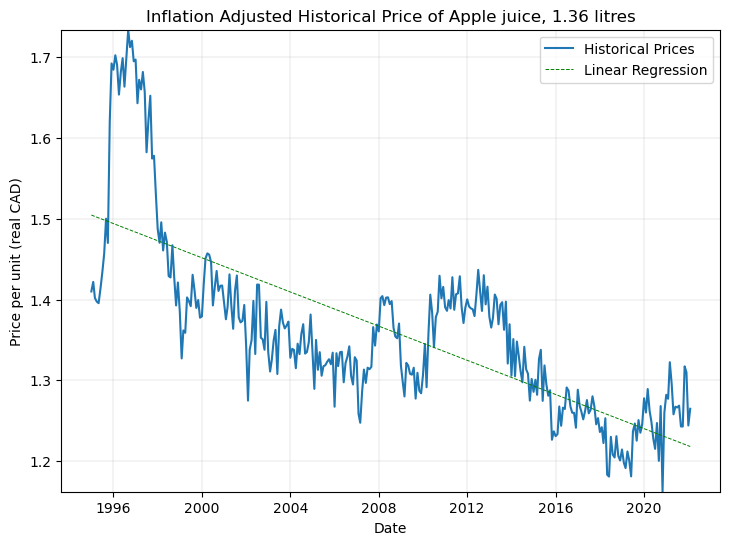

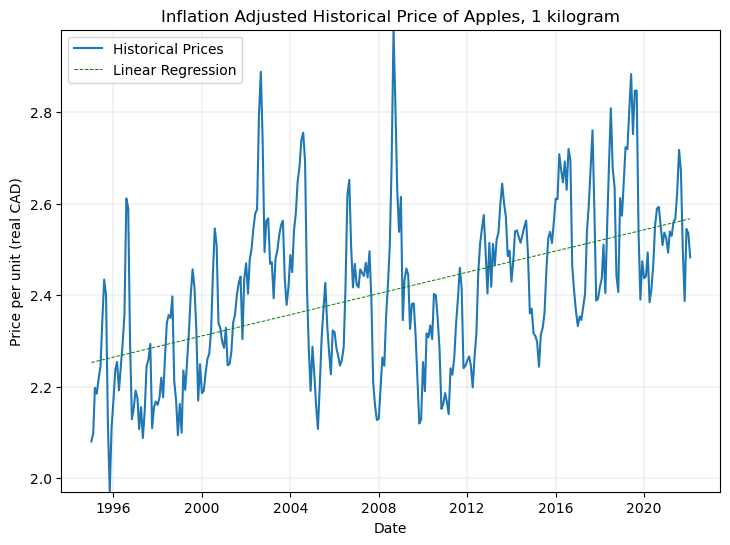

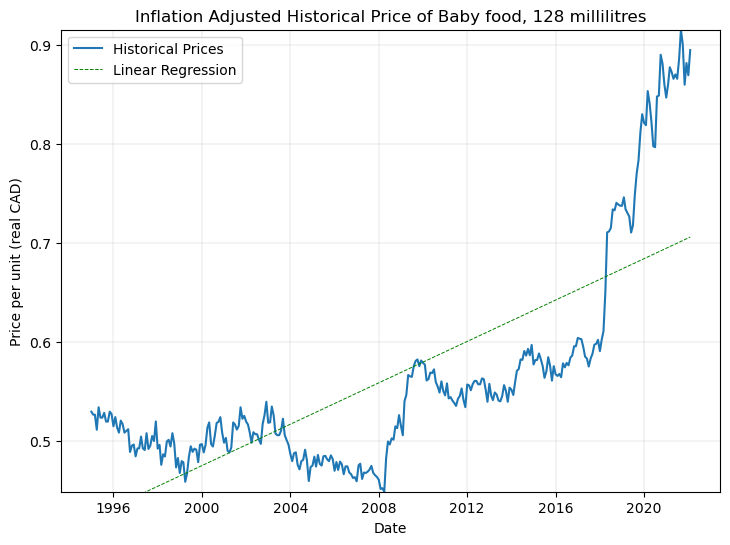

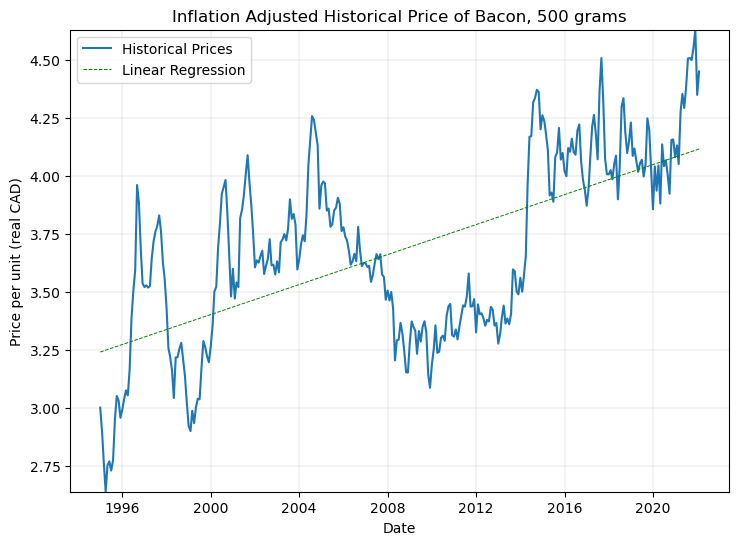

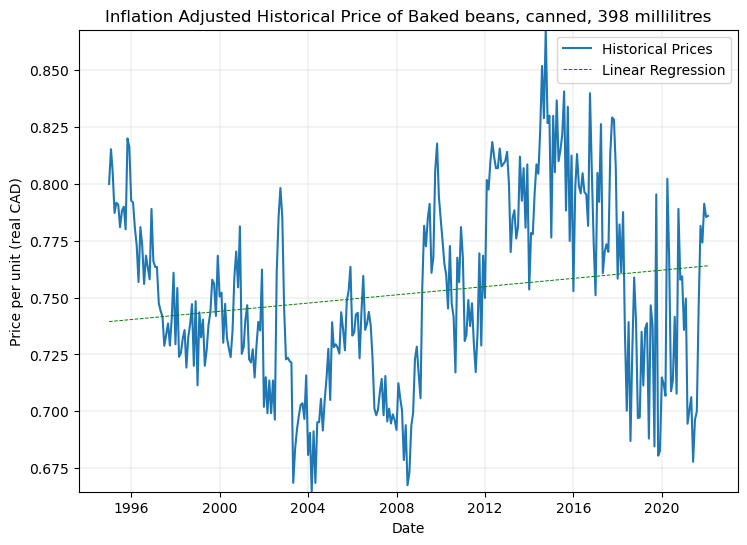

...

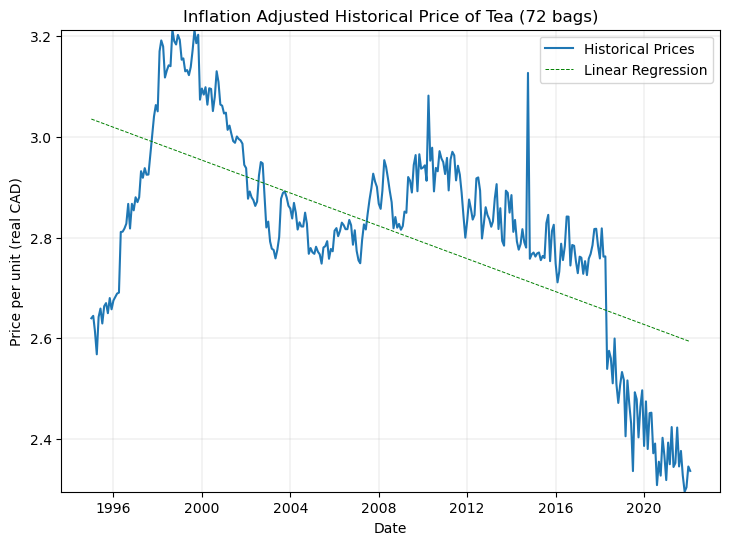

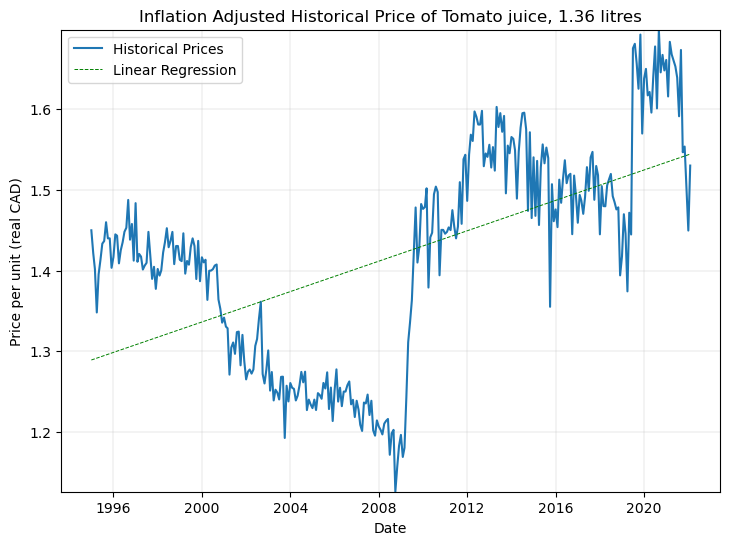

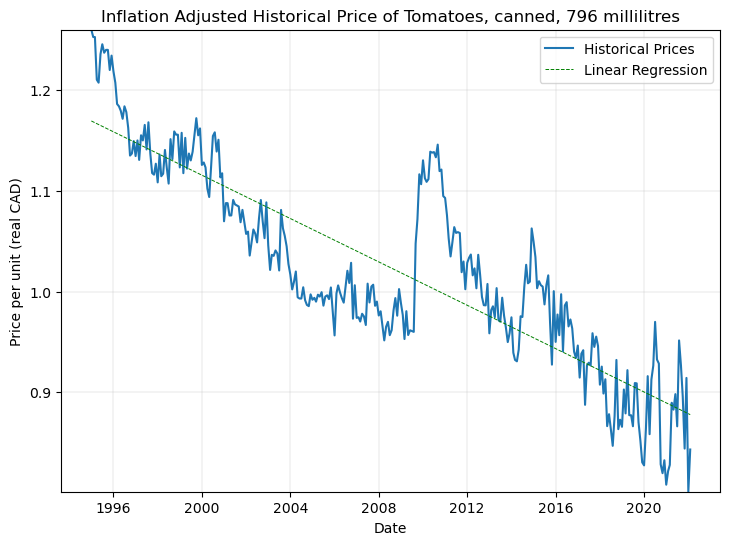

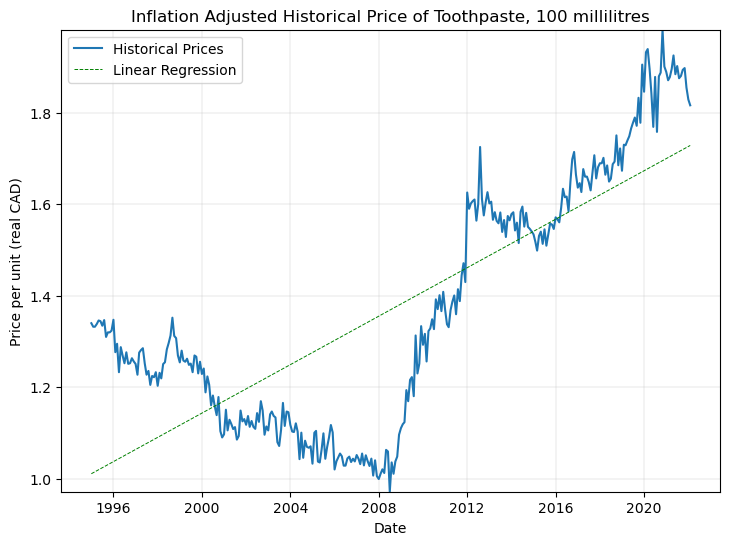

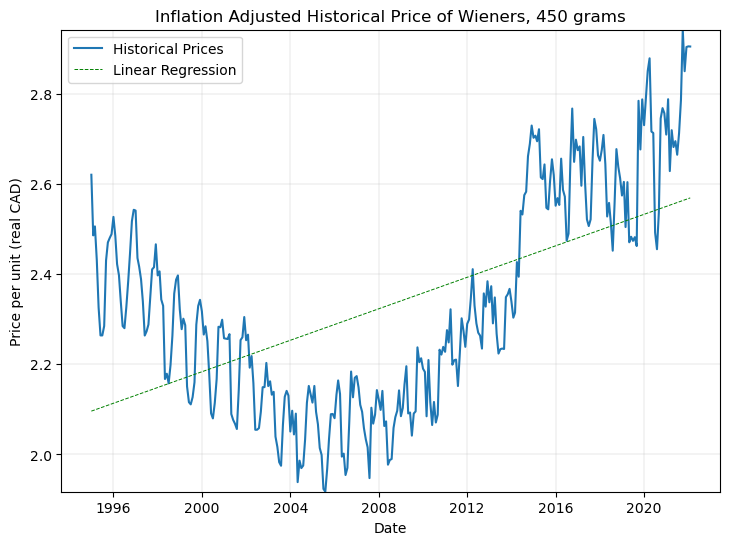

Products with largest price increase after adjusting for inflation: ['Sirloin steak, 1 kilogram', 'Stewing beef, 1 kilogram', 'Ground beef, 1 kilogram', 'Blade roast, 1 kilogram', 'Prime rib roast, 1 kilogram', 'Cigarettes (200)']
Products with largest price decrease after adjusting for inflation: ['Regular, unleaded gasoline at self-service stations, cents per litre', 'Pork chops, 1 kilogram', 'Coffee, instant, 200 grams', 'Processed cheese slices, 250 grams', 'Cooking or salad oil, 1 litre', 'Peanut butter, 500 grams']
Most volatile product prices after adjusting for inflation: ['Sirloin steak, 1 kilogram', 'Ground beef, 1 kilogram', 'Blade roast, 1 kilogram', 'Prime rib roast, 1 kilogram', 'Regular, unleaded gasoline at self-service stations, cents per litre', 'Cigarettes (200)']
Least volatile product prices after adjusting for inflation: ['Soup, canned, 284 millilitres', 'Baked beans, canned, 398 millilitres', 'Partly skimmed milk, 4 litres', 'Homogenized milk, 4 litres', 'French 

In [15]:
# Plot each product in the Products column's price history for the Monthly average retail prices for food in Canada from JAN 1995 to FEB 2022 dataset

# Test datafrane and plotting on just one group of products before running a loop - commented out once working properly

# historical_test_df = historical_df[historical_df['Products'] == 'Carrots, 1 kilogram']

# plt.figure(figsize=(8.5,6))
# plt.xlabel('Date')
# plt.ylabel('Price per unit (CAD)')
# plt.title(f'Inflation Adjusted Historical Price (Tested Carrots, 1 kilogram)')
# plt.plot(historical_test_df['REF_DATE'], historical_test_df['Real_VALUE'])
# plt.grid(linestyle='-', linewidth=0.2)
# plt.show()


# For loop to generate historical price charts for each group of products:
# First we group the products in the dataframe

historical_df_grouped = historical_df.groupby('Products')

# Create a lists to store product names and their price changes to determine which changed most over the dataset

historical_price_changes = [] # for largest price increases and decreases
historical_price_volatilities = [] # for standard deviation and volatility

# Loop through each group and plot the data with regression line
for name, group in historical_df_grouped:
    # Convert dates to ordinal format for regression as per Curriculum - Machine Learning 1, using alternative method because the x axis would not display properly
    x_historical_df = group['REF_DATE'].map(pd.Timestamp.toordinal).values.reshape(-1, 1)
    y_historical_df = group['Real_VALUE'].values # change to VALUE_price here for non-inflation adjusted figures

    # Fit the linear regression model
    model = LinearRegression()
    model.fit(x_historical_df, y_historical_df)

    # Predict values using linear regression model
    y_pred = model.predict(x_historical_df)

    # Calculate price change using the regression line
    historical_price_change = y_pred[-1] - y_pred[0]
    historical_price_changes.append((name, historical_price_change))

    # Calculate price volatility using standard deviation
    historical_price_volatility = group['Real_VALUE'].std()
    historical_price_volatilities.append((name, historical_price_volatility))

    # Plot historical price data
    plt.figure(figsize=(8.5, 6))
    plt.xlabel('Date')
    plt.ylabel('Price per unit (real CAD)')
    plt.ylim(group['Real_VALUE'].min(), group['Real_VALUE'].max())
    plt.title(f'Inflation Adjusted Historical Price of {name}')
    plt.plot(group['REF_DATE'], group['Real_VALUE'], label='Historical Prices')

    # Plot regression line
    plt.plot(group['REF_DATE'], y_pred, color='g', linestyle='dashed', label='Linear Regression', linewidth=0.7)
    
    # Plot grid and legend
    plt.grid(linestyle='-', linewidth=0.2)
    plt.legend()
    plt.show()

# Fetch top increases and decreases across our historical price dataset

historical_price_changes.sort(key=lambda x: x[1])
top_decreases = historical_price_changes[:6] # change number printed with these
top_increases = historical_price_changes[-6:]

# Sort price volatilities to find the most and least volatile products

historical_price_volatilities.sort(key=lambda x: x[1])
most_volatile = historical_price_volatilities[-6:]
least_volatile = historical_price_volatilities[:6]

# Print results

print("Products with largest price increase after adjusting for inflation:", [item[0] for item in top_increases])
print("Products with largest price decrease after adjusting for inflation:", [item[0] for item in top_decreases])
print("Most volatile product prices after adjusting for inflation:", [item[0] for item in most_volatile])
print("Least volatile product prices after adjusting for inflation:", [item[0] for item in least_volatile])


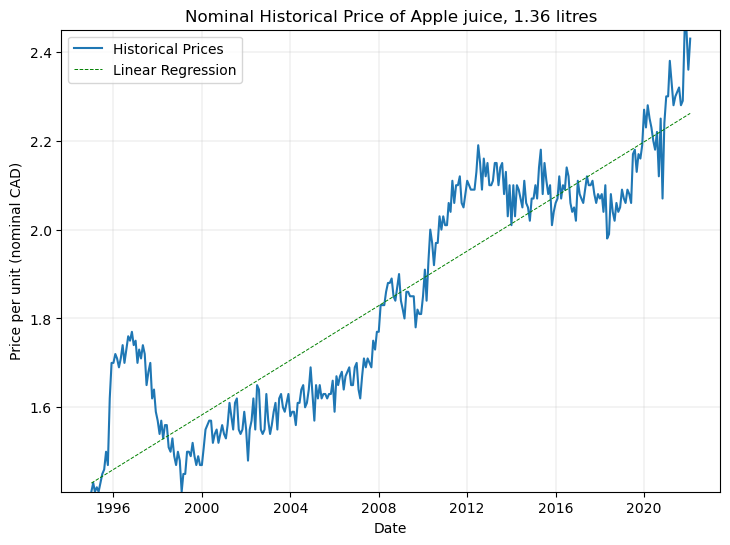

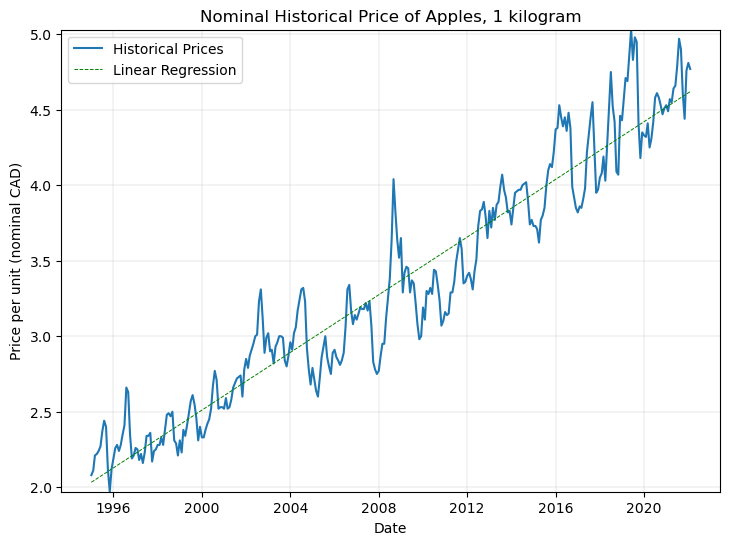

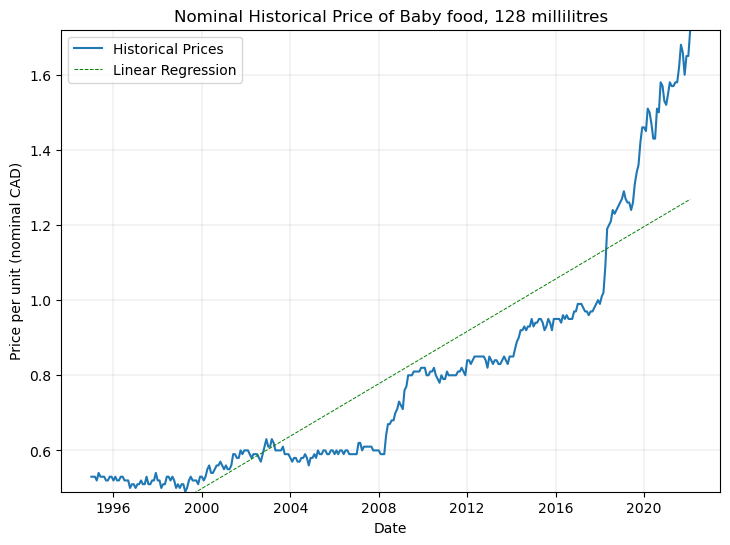

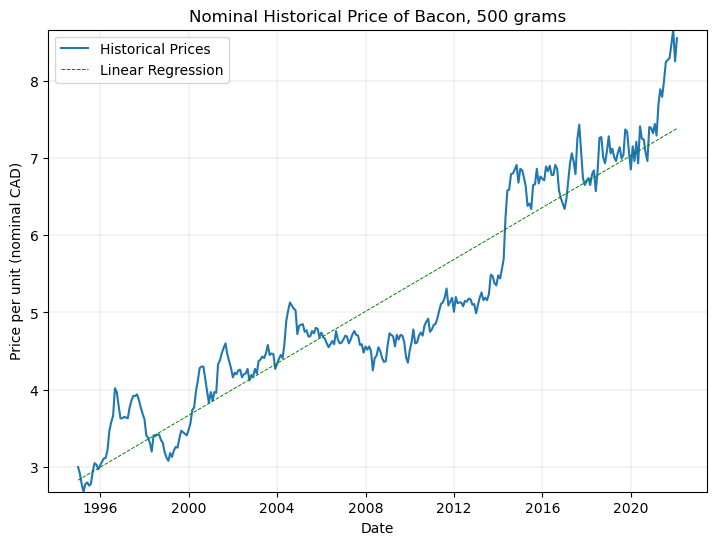

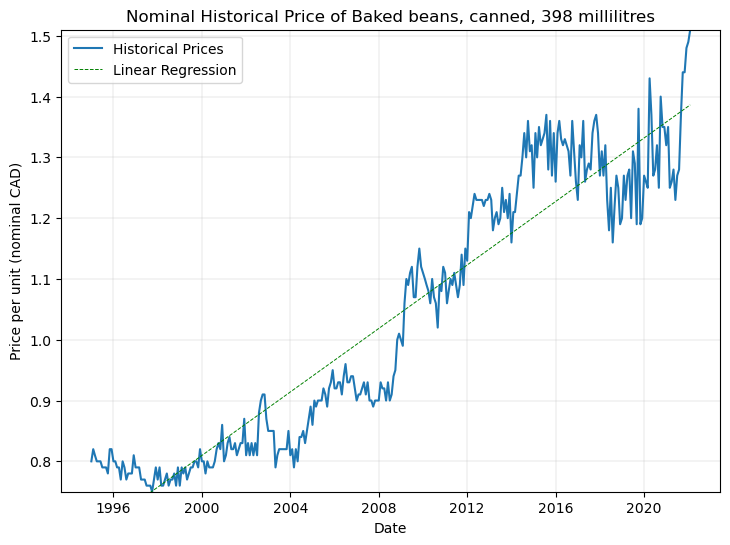

...

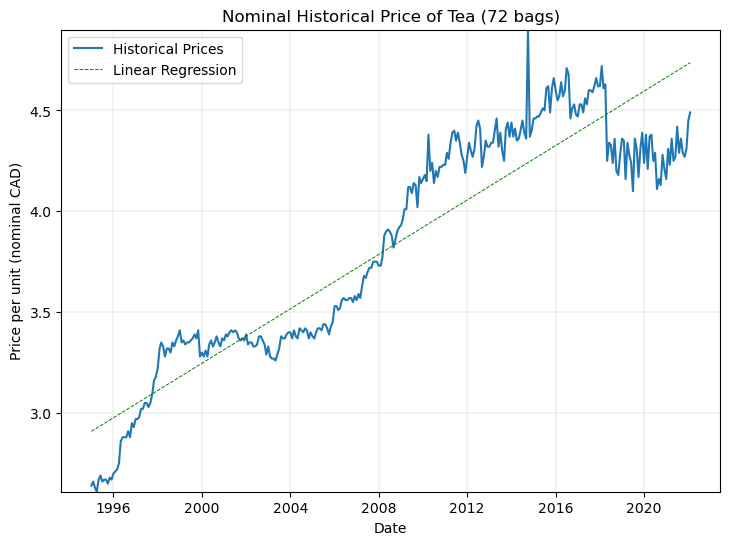

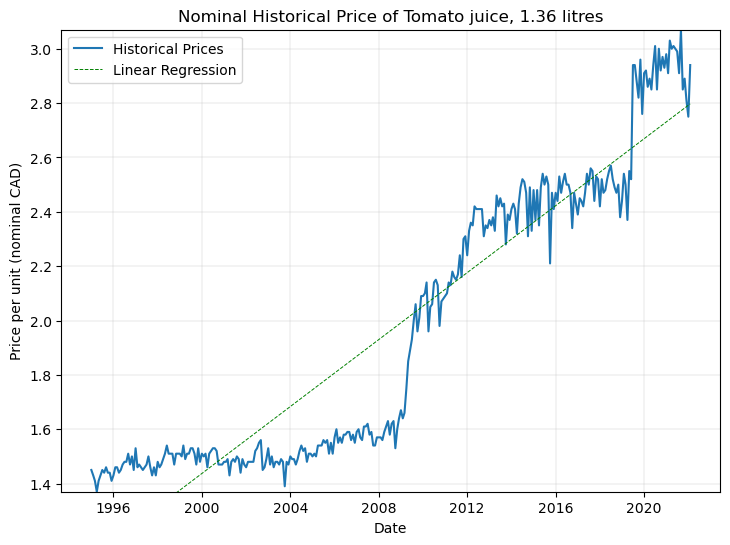

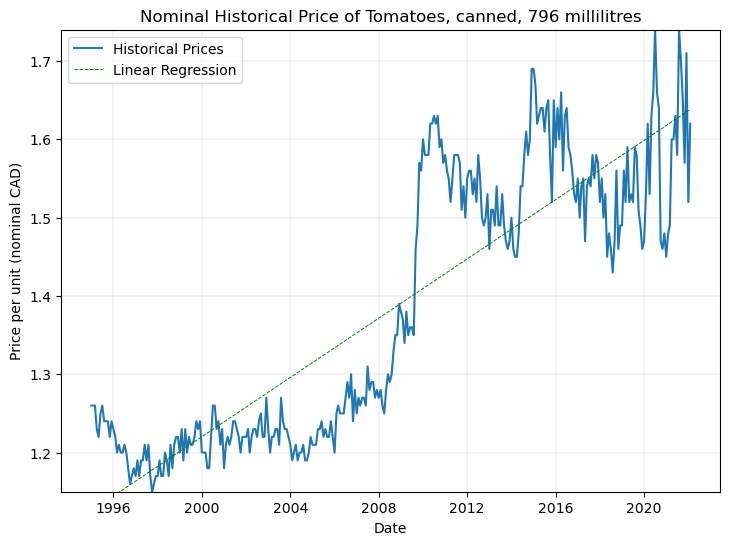

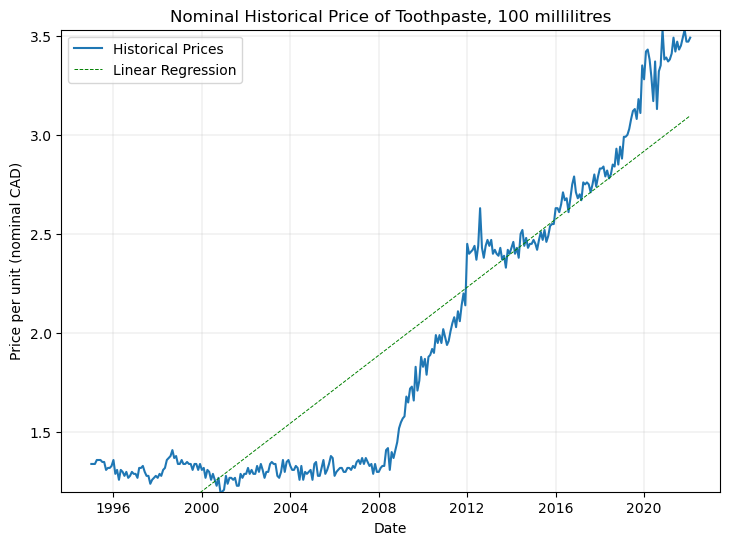

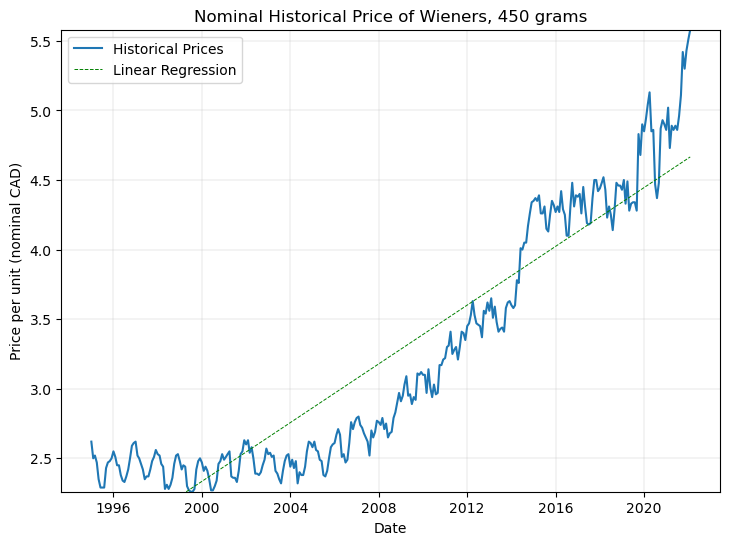

Products with largest price increase after adjusting for inflation: ['Regular, unleaded gasoline at self-service stations, cents per litre', 'Prime rib roast, 1 kilogram', 'Prime rib roast, 1 kilogram', 'Cigarettes (200)', 'Cigarettes (200)', 'Cigarettes (200)']
Products with largest price decrease after adjusting for inflation: ['Regular, unleaded gasoline at self-service stations, cents per litre', 'Pork chops, 1 kilogram', 'Coffee, instant, 200 grams', 'Processed cheese slices, 250 grams', 'Cooking or salad oil, 1 litre', 'Peanut butter, 500 grams']
Most volatile product prices after adjusting for inflation: ['Regular, unleaded gasoline at self-service stations, cents per litre', 'Regular, unleaded gasoline at self-service stations, cents per litre', 'Cigarettes (200)', 'Cigarettes (200)', 'Regular, unleaded gasoline at self-service stations, cents per litre', 'Cigarettes (200)']
Least volatile product prices after adjusting for inflation: ['Soup, canned, 284 millilitres', 'Soup, ca

In [18]:
# Loop through each group and plot nominal price data with regression line
for name, group in historical_df_grouped:
    # Convert dates to ordinal format for regression as per Curriculum - Machine Learning 1, using alternative method because the x axis would not display properly
    x_historical_df = group['REF_DATE'].map(pd.Timestamp.toordinal).values.reshape(-1, 1)
    y_historical_df = group['VALUE_price'].values # changed to VALUE_price here for non-inflation adjusted figures

    # Fit the linear regression model
    model = LinearRegression()
    model.fit(x_historical_df, y_historical_df)

    # Predict values using linear regression model
    y_pred = model.predict(x_historical_df)

    # Calculate price change using the regression line
    historical_price_change = y_pred[-1] - y_pred[0]
    historical_price_changes.append((name, historical_price_change))

    # Calculate price volatility using standard deviation
    historical_price_volatility = group['VALUE_price'].std()
    historical_price_volatilities.append((name, historical_price_volatility))

    # Plot historical price data
    plt.figure(figsize=(8.5, 6))
    plt.xlabel('Date')
    plt.ylabel('Price per unit (nominal CAD)')
    plt.ylim(group['VALUE_price'].min(), group['VALUE_price'].max())
    plt.title(f'Nominal Historical Price of {name}')
    plt.plot(group['REF_DATE'], group['VALUE_price'], label='Historical Prices')

    # Plot regression line
    plt.plot(group['REF_DATE'], y_pred, color='g', linestyle='dashed', label='Linear Regression', linewidth=0.7)
    
    # Plot grid and legend
    plt.grid(linestyle='-', linewidth=0.2)
    plt.legend()
    plt.show()

Null report:
 REF_DATE                                          0
GEO                                               0
Food expenditures, summary-level categories       0
UOM                                               0
VALUE                                          4031
dtype: int64


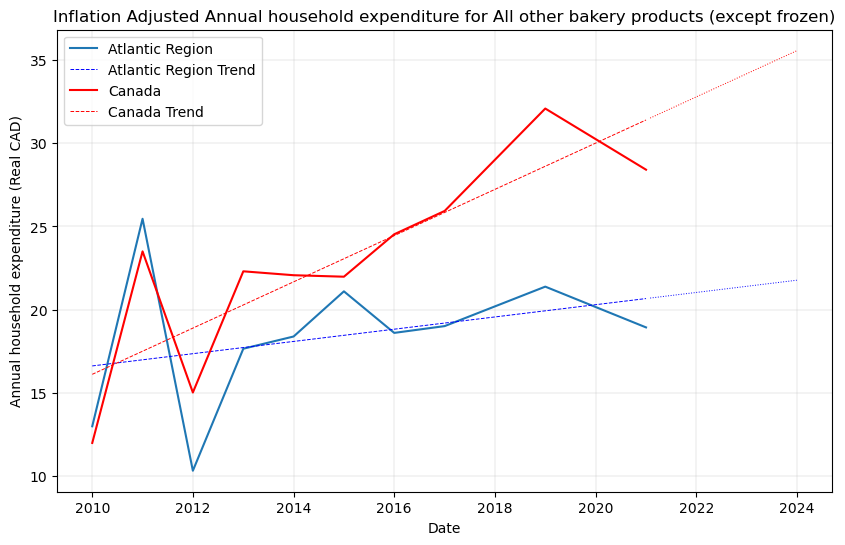

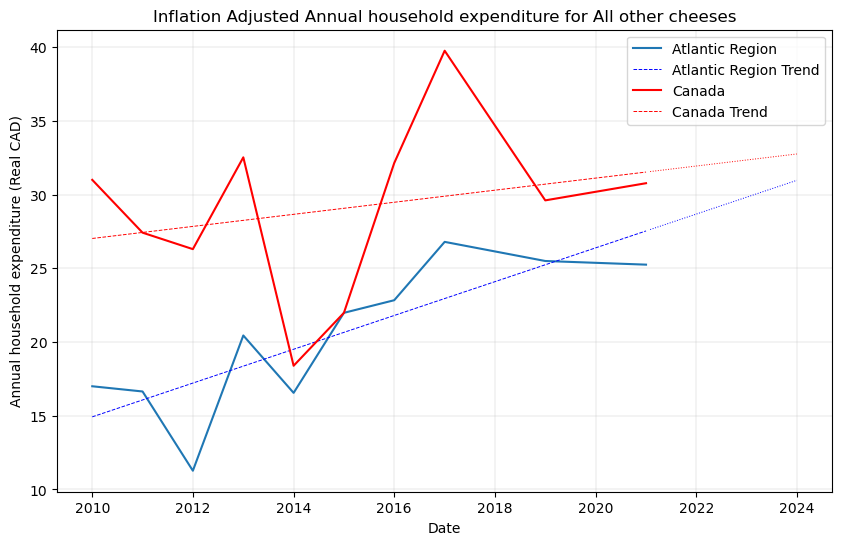

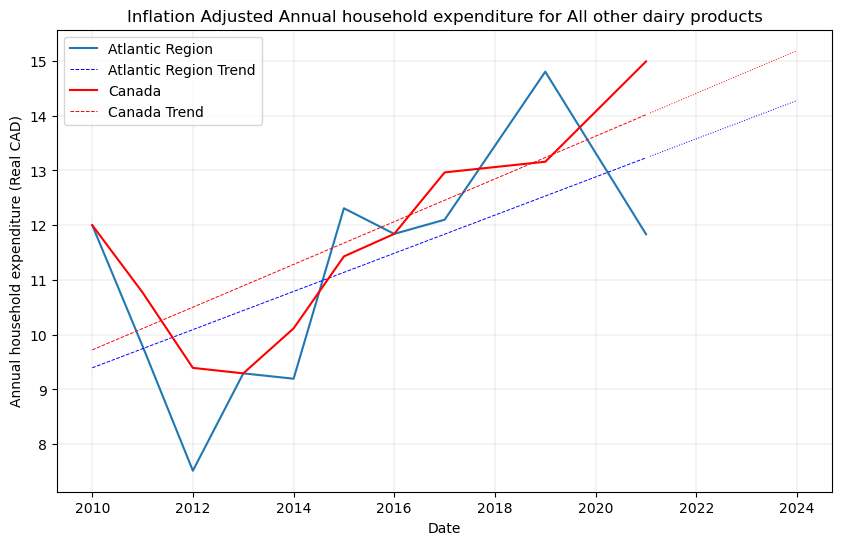

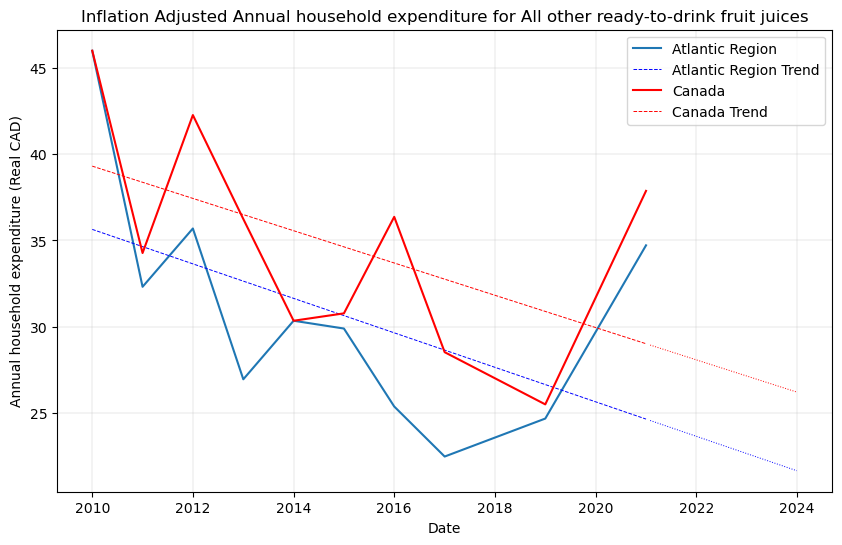

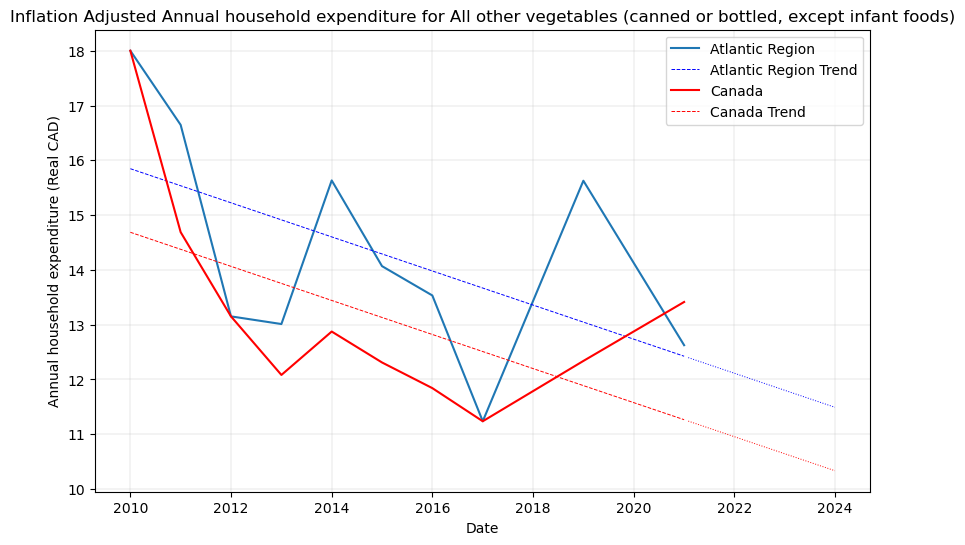

...

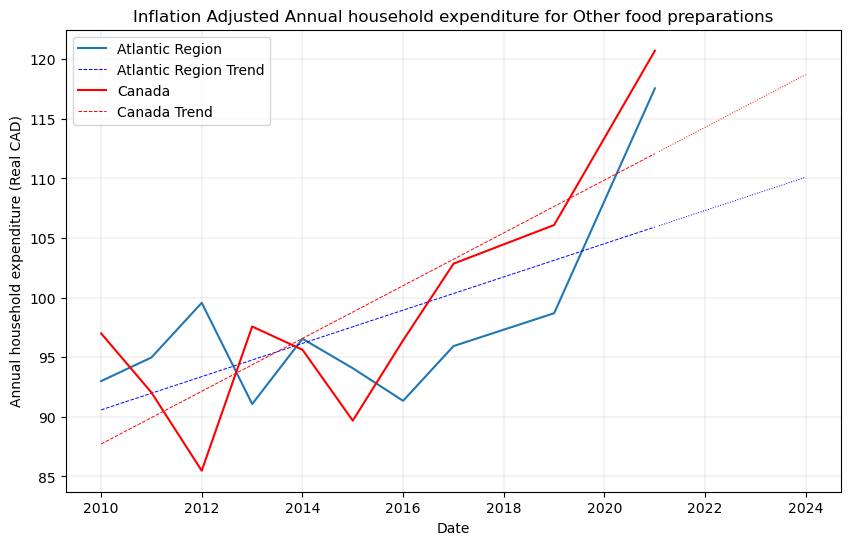

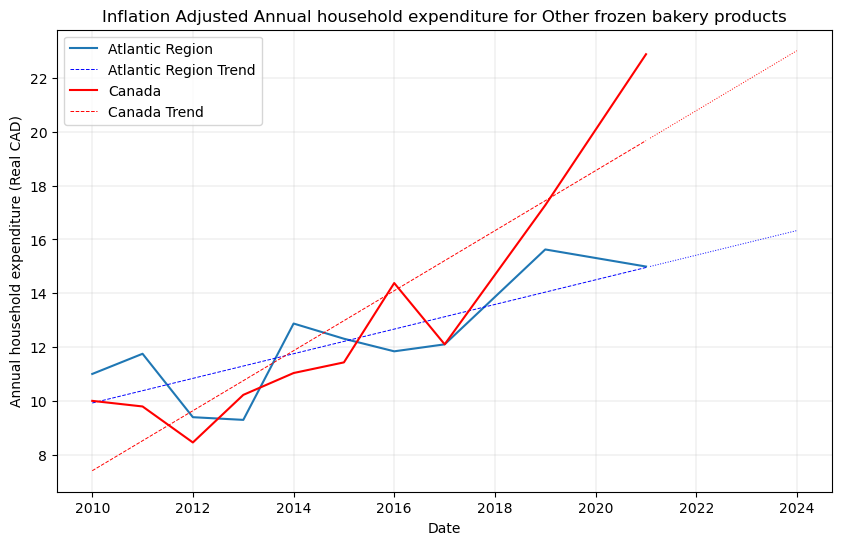

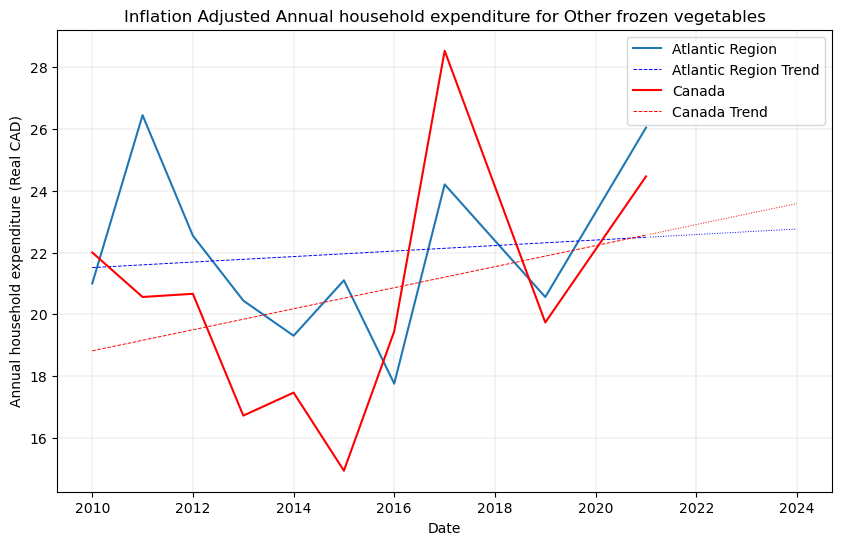

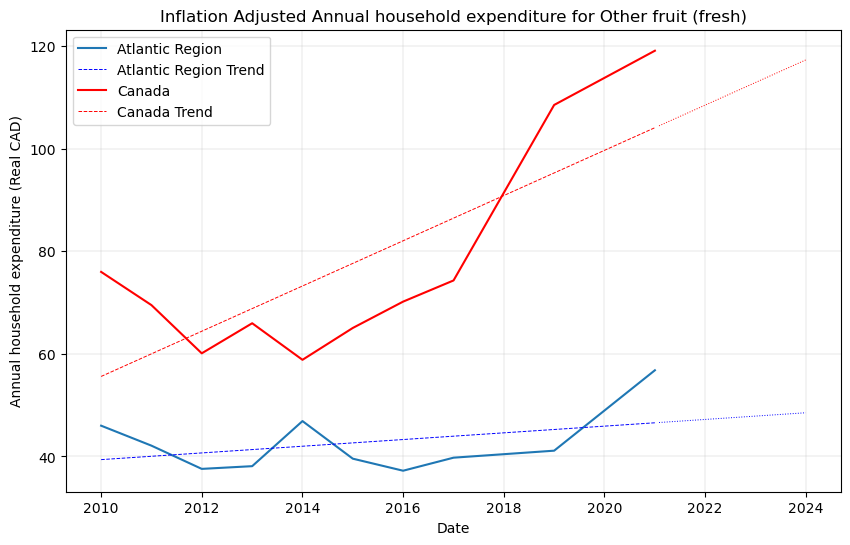

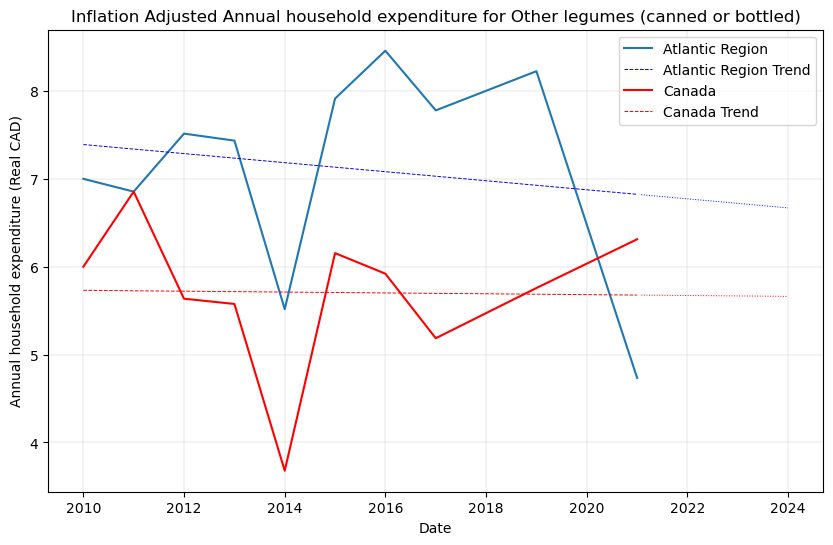

ValueError: Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by LinearRegression.

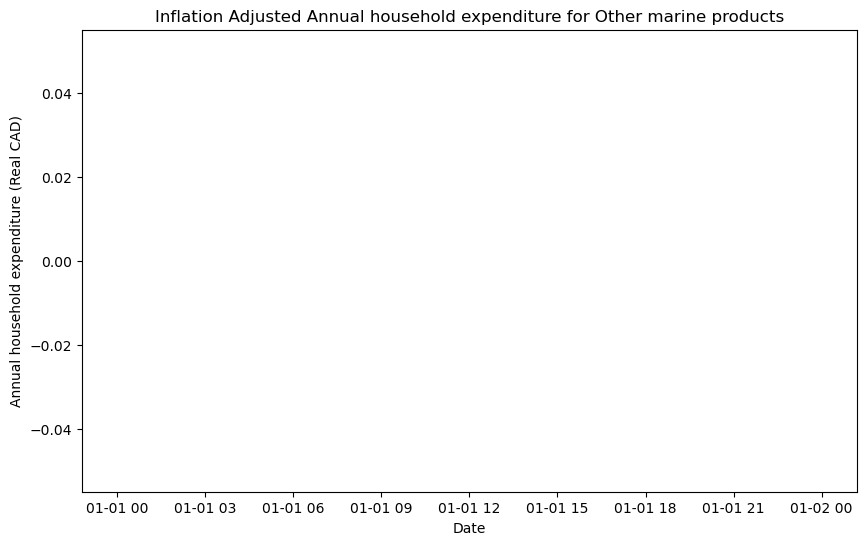

In [12]:
# Code for annual Detailed food spending, Canada, regions and provinces from 2010 to 2021 dataset

# Select dataset
food_spending_data_path = 'isp_data/data/Detailed food spending, Canada, regions and provinces/11100125.csv'

# Create a dataframe of monthly average retail prices for food

food_spending_df = pd.read_csv(food_spending_data_path)

# Drop unused columns

food_spending_df.drop(columns=['DGUID','Statistic','UOM_ID','SCALAR_FACTOR','SCALAR_ID','VECTOR',
                 'COORDINATE','STATUS','SYMBOL','TERMINATED','DECIMALS'], inplace=True)

# Change data type of year entries in REF_DATE column to datetime

food_spending_df['REF_DATE'] = pd.to_datetime(food_spending_df['REF_DATE'], format='%Y')

# Check for nulls and print a readout listing any

print("Null report:\n",food_spending_df.isna().sum())

# Drop rows with nulls

food_spending_df.dropna(inplace=True)

# Adjust for inflation using Food_CPI_df filtered to entries for Canada, and use the first row to set the base CPI time series

food_spending_df = pd.merge(food_spending_df, Canada_Food_CPI_df[['REF_DATE', 'VALUE']], on='REF_DATE', suffixes=('_price', '_cpi'))

food_spending_base_cpi = food_spending_df.iloc[0]['VALUE_cpi']

# Add CPI adjusted value column to dataframe as "Real_VALUE." VALUE_price is the original nominal value.

food_spending_df['Real_VALUE'] = food_spending_df['VALUE_price'] * (food_spending_base_cpi / food_spending_df['VALUE_cpi'])

# Linear regression model

reg_model = LinearRegression()

# Plot Atlantic Region and Canada monthly expenditures as separate lines and regressions on one plot per Food Expenditures, summary-level categories entry group

### Test this first by plotting one product entry before running a loop, commented out once working properly

# food_spending_test_df = food_spending_df[(food_spending_df['GEO'].isin(["Atlantic Region", "Canada"])) &
#                                         (food_spending_df['Food expenditures, summary-level categories'] == 'Eggs')]

# plt.figure(figsize=(8.5, 6))
# plt.xlabel('Date')
# plt.ylabel('Annual household expenditure (CAD)')
# plt.title('Test - Annual household expenditure (Eggs)')

# # Plot data for the Atlantic Region
# plt.plot(food_spending_test_df[food_spending_test_df['GEO'] == 'Atlantic Region']['REF_DATE'],
#          food_spending_test_df[food_spending_test_df['GEO'] == 'Atlantic Region']['Real_VALUE'],
#          label='Atlantic Region')

# # Plot data for Canada
# plt.plot(food_spending_test_df[food_spending_test_df['GEO'] == 'Canada']['REF_DATE'],
#          food_spending_test_df[food_spending_test_df['GEO'] == 'Canada']['Real_VALUE'],
#          label='Canada', color='r')

# # Add grid lines and legend
# plt.grid(linestyle='-', linewidth=0.2)
# plt.legend()

# plt.show()
###

# Group dataframe by 'Food expenditures, summary-level categories'

food_spending_df_grouped = food_spending_df.groupby('Food expenditures, summary-level categories')

# Loop through each group and plot data for the Atlantic Region and Canada with distinct regression lines

for category, group in food_spending_df_grouped:
    plt.figure(figsize=(10, 6))
    plt.xlabel('Date')
    plt.ylabel('Annual household expenditure (real CAD)')
    plt.title(f'Inflation Adjusted Annual Household Expenditure for {category}')
    
    # Filter data for Atlantic Region
    atlantic_data = group[group['GEO'] == 'Atlantic Region'].dropna(subset=['REF_DATE', 'Real_VALUE'])
    plt.plot(atlantic_data['REF_DATE'], atlantic_data['Real_VALUE'], label='Atlantic Region')

    # Prepare data for regression
    x_historical_atlantic = atlantic_data['REF_DATE'].map(pd.Timestamp.toordinal).values.reshape(-1, 1)
    y_historical_atlantic = atlantic_data['Real_VALUE'].values
   
    # Train model on full dataset for Atlantic Region
    reg_atlantic = reg_model.fit(x_historical_atlantic, y_historical_atlantic)
    
    # Predict historical values for plotting
    atlantic_predictions = reg_atlantic.predict(x_historical_atlantic)
    plt.plot(atlantic_data['REF_DATE'], atlantic_predictions, linestyle='dashed', color='blue', label='Atlantic Region Trend', linewidth=0.7)

    # Generate and plot future predictions for Atlantic Region
    last_date_atlantic = atlantic_data['REF_DATE'].max()
    future_dates_atlantic = pd.date_range(last_date_atlantic, periods=36, freq='M')
    future_dates_ord_atlantic = future_dates_atlantic.map(pd.Timestamp.toordinal).values.reshape(-1, 1)
    future_values_atlantic = reg_atlantic.predict(future_dates_ord_atlantic)
    plt.plot(future_dates_atlantic, future_values_atlantic, linestyle='dotted', color='blue', linewidth=0.7)

    # Filter data for Canada
    canada_data = group[group['GEO'] == 'Canada'].dropna(subset=['REF_DATE', 'Real_VALUE'])
    plt.plot(canada_data['REF_DATE'], canada_data['Real_VALUE'], label='Canada', color='r')

    # Prepare data for regression for Canada
    x_historical_canada = canada_data['REF_DATE'].map(pd.Timestamp.toordinal).values.reshape(-1, 1)
    y_historical_canada = canada_data['Real_VALUE'].values
    
    # Train model on full dataset for Canada
    reg_canada = reg_model.fit(x_historical_canada, y_historical_canada)
    
    # Predict historical values for plotting
    canada_predictions = reg_canada.predict(x_historical_canada)
    plt.plot(canada_data['REF_DATE'], canada_predictions, linestyle='dashed', color='red', label='Canada Trend', linewidth=0.7)

    # Generate and plot future predictions for Canada
    last_date_canada = canada_data['REF_DATE'].max()
    future_dates_canada = pd.date_range(last_date_canada, periods=36, freq='M')
    future_dates_ord_canada = future_dates_canada.map(pd.Timestamp.toordinal).values.reshape(-1, 1)
    future_values_canada = reg_canada.predict(future_dates_ord_canada)
    plt.plot(future_dates_canada, future_values_canada, linestyle='dotted', color='red', linewidth=0.7)

    # Plot grid and legend
    plt.grid(linestyle='-', linewidth=0.2)
    plt.legend()
    plt.show()


    # ## Model evaluation code - commented out but retained for testing
    
    # from sklearn.metrics import mean_absolute_error # Required if evaluating model fit
    
    # # Splitting Atlantic Region dataset into test/train for Atlantic Region future annual expenditure predictions
    # atlantic_X_train, atlantic_X_test, atlantic_y_train, atlantic_y_test = train_test_split(x_historical_atlantic, y_historical_atlantic, test_size = 0.2, random_state = 0)
    
    # reg_atlantic = reg_model.fit(atlantic_X_train, atlantic_y_train)
    # plt.plot(atlantic_data['REF_DATE'], reg_atlantic.predict(atlantic_X_test), linestyle='dashed', color='blue', label='Atlantic Region Trend', linewidth=0.7)

    # future_reg_atlantic = reg_model.fit(atlantic_X_train, atlantic_y_train)

    # # evaluate the model # just use this to check things are working and seem ok # not working 100%
    # yhat = model.predict(atlantic_X_test)
    # # evaluate predictions
    # mae = mean_absolute_error(atlantic_y_test, yhat)
    # print('Atlantic MAE: %.3f' % mae)
    # print(model.score(atlantic_X_train, atlantic_y_train))
    # print(model.score(atlantic_X_test, atlantic_y_test))

    # plot this model
    # plt.plot(atlantic_data['REF_DATE'], future_reg_atlantic.predict(atlantic_X_train), linestyle='dashed', color='blue', label='Atlantic Region Future Trend', linewidth=0.7)

    # ###

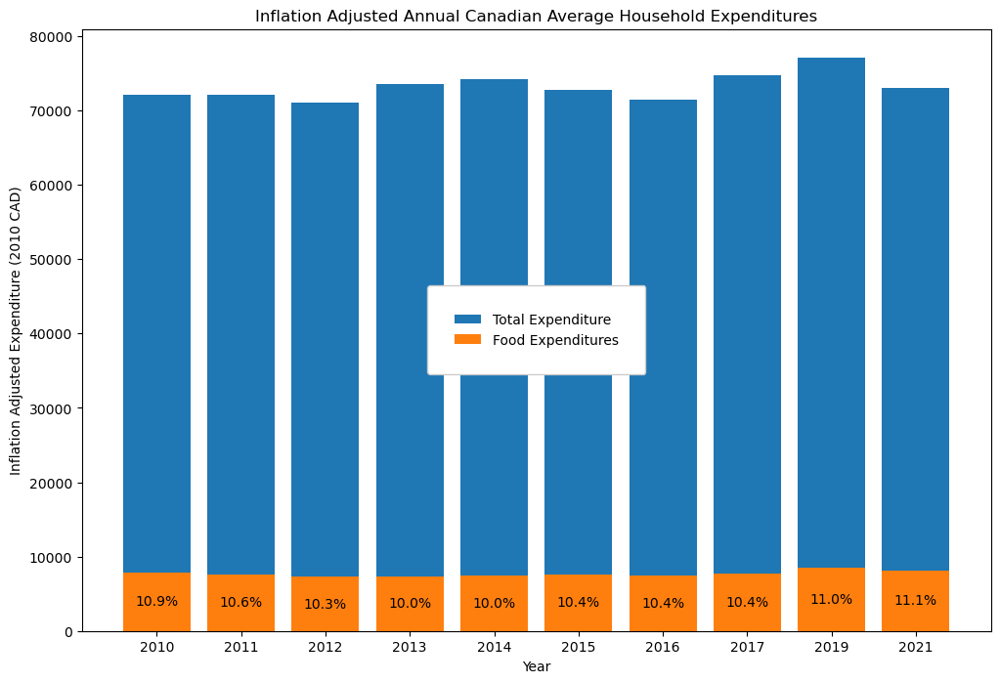

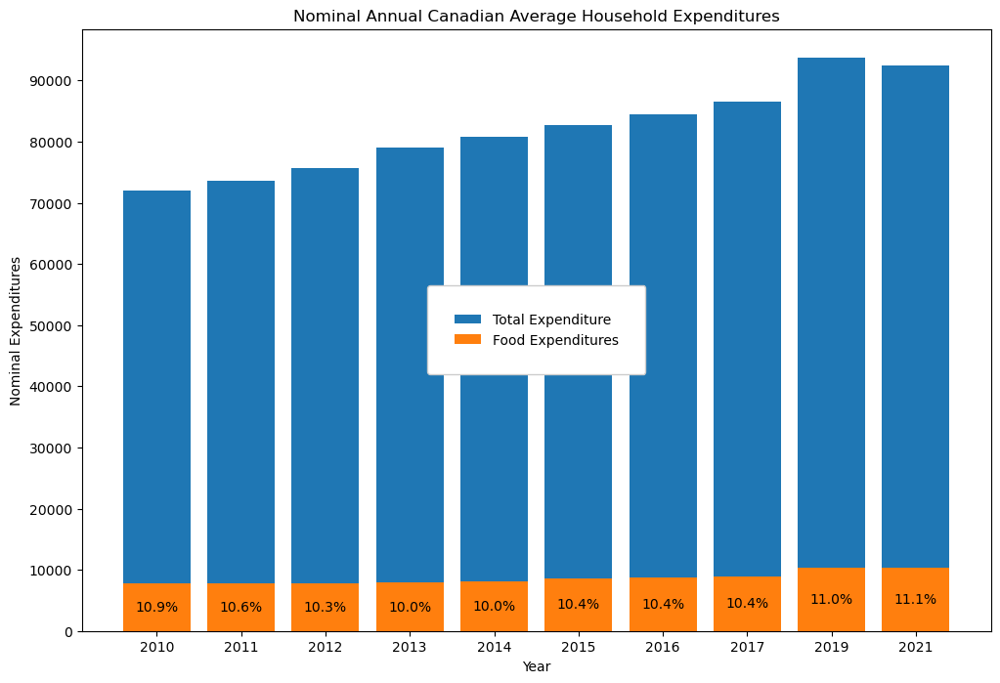

In [26]:
# Comparative Analysis of Household spending by Household type from 2010 to 2021 dataset
# We will use annual average total expenditures and annual average food expenditures to show how food as a share of total spending in Canada has changed using stacked bar charts. 
# Entries exist only for Canada without regional breakdown.

# Select dataset

household_spending_data_path = 'isp_data/data/Household spending by household type/11100224.csv'

# Create a dataframe of monthly average retail prices for food

household_spending_df = pd.read_csv(household_spending_data_path)

# Drop unused columns

household_spending_df.drop(columns=['GEO','DGUID','UOM_ID','SCALAR_FACTOR','SCALAR_ID','VECTOR',
                                    'COORDINATE','STATUS','SYMBOL','TERMINATED','DECIMALS'], inplace=True)

# Check for nulls and print a readout listing any

# print(household_spending_df.isna().sum())

# Drop all rows not containing relevant or interesting strings being used

relevant_spending_entries = ['Total expenditure', 'Food expenditures']

# other_spending_entries = ['Total expenditure', 'Food expenditures', 'Food purchased from stores', 'Bakery products', 'Cereal grains and cereal products', 'Fruit, fruit preparations and nuts', 'Vegetables and vegetable preparations',
#  'Dairy products and eggs', 'Fish and seafood', 'Non-alcoholic beverages and other food products', 'Food purchased from restaurants', 'Restaurant meals', 'Restaurant snacks and beverages', 'Shelter', 'Principal accommodation',
#  'Rent', 'Tobacco products and alcoholic beverages', 'Cigarettes', 'Alcoholic beverages'] # retained for potential future analyses

household_spending_df = household_spending_df[household_spending_df['Household expenditures, summary-level categories'].isin(relevant_spending_entries)]

# Drop Household types other than All Classes. Adapt line below to include other Household types.

household_spending_df = household_spending_df[household_spending_df['Household type'] == 'All classes']

# Change data type of REF_DATE column to datetime, trim to just year as these are annual entries
household_spending_df['REF_DATE'] = pd.to_datetime(household_spending_df['REF_DATE'], format='%Y')

# Create dataframe that adjusts for inflation by factoring in CPI
# Adjust for inflation by merging Food_CPI_df filtered to entries for Canada as Canada_Food_CPI_df

cpi_household_spending_df = pd.merge(household_spending_df, Canada_Food_CPI_df[['REF_DATE', 'VALUE']], on='REF_DATE', suffixes=('_price', '_cpi'))

# Use the first row to set the base CPI

household_spending_base_cpi = cpi_household_spending_df.iloc[0]['VALUE_cpi']

# Add CPI adjusted value column to dataframe as "Real_VALUE." VALUE_price is the original nominal value.
# Note that we are using our food cpi dataframe to also adjust non-food expenditure categories, which is not ideal but a simplification for this project

cpi_household_spending_df['Real_VALUE'] = cpi_household_spending_df['VALUE_price'] * (household_spending_base_cpi / cpi_household_spending_df['VALUE_cpi'])

# Convert REF_DATE to datetime and keep year
cpi_household_spending_df['REF_DATE'] = pd.to_datetime(cpi_household_spending_df['REF_DATE']).dt.year

# Create a new column for the percentage of total expenditure to grab percentage of expenditure for food after adjusting for inflation
cpi_household_spending_df['cpi_percentage_of_total_expenditure'] = cpi_household_spending_df.apply(lambda row: (row['Real_VALUE'] / cpi_household_spending_df[(cpi_household_spending_df['REF_DATE'] == row['REF_DATE']) & 
        (cpi_household_spending_df['Household expenditures, summary-level categories'] == 'Total expenditure')]['Real_VALUE'].values[0]) * 100, axis=1)

# Pivot dataframe for plotting
cpi_pivot_df = cpi_household_spending_df.pivot_table(index='REF_DATE', columns='Household expenditures, summary-level categories', values='Real_VALUE')

# Reset index for plotting
cpi_pivot_df = cpi_pivot_df.reset_index()

# Set positions
bar_positions = range(len(cpi_pivot_df))

# Plot inflation adjusted chart
plt.figure(figsize=(12, 8))

# Plot bars for Food expenditures within the Total expenditure
plt.bar(bar_positions, cpi_pivot_df['Total expenditure'], label='Total Expenditure')
plt.bar(bar_positions, cpi_pivot_df['Food expenditures'], width=0.8, bottom=0, label='Food Expenditures')
# Add labels for Food Expenditure
for i in range(len(cpi_pivot_df)):
    food_expenditure = cpi_pivot_df['Food expenditures'].iloc[i]
    total = cpi_pivot_df['Total expenditure'].iloc[i]
    percentage = (food_expenditure / total) * 100
    plt.text(i, food_expenditure / 2, f"{percentage:.1f}%", ha='center', va='center')

# Labels and Title
plt.ylabel('Inflation Adjusted Expenditure (2010 CAD)')
plt.xlabel('Year')
plt.title('Inflation Adjusted Annual Canadian Average Household Expenditures')
plt.xticks(bar_positions, cpi_pivot_df['REF_DATE'])
plt.yticks()
plt.legend(loc='center', framealpha=1, borderpad=2)

plt.show()

# Plot non-inflation adjusted chart below
# # Add percentage of total expenditure for each year in new column
household_spending_df['percentage_of_total_expenditure'] = household_spending_df.apply(lambda row: (row['VALUE'] / household_spending_df[(household_spending_df['REF_DATE'] == row['REF_DATE']) & 
        (household_spending_df['Household expenditures, summary-level categories'] == 'Total expenditure')]['VALUE'].values[0]) * 100, axis=1)

# Convert REF_DATE to datetime and keep year
household_spending_df['REF_DATE'] = pd.to_datetime(household_spending_df['REF_DATE']).dt.year

# Pivot dataframe for plotting
pivot_df = household_spending_df.pivot_table(index='REF_DATE', columns='Household expenditures, summary-level categories', values='VALUE')

# Reset index for plotting
pivot_df = pivot_df.reset_index()

# Set positions
bar_positions = range(len(pivot_df))

# Plot inflation adjusted chart
plt.figure(figsize=(12, 8))

# Plot bars for Food expenditures within the Total expenditure
plt.bar(bar_positions, pivot_df['Total expenditure'], label='Total Expenditure')
plt.bar(bar_positions, pivot_df['Food expenditures'], width=0.8, bottom=0, label='Food Expenditures')
# Add labels for Food Expenditure
for i in range(len(pivot_df)):
    food_expenditure = pivot_df['Food expenditures'].iloc[i]
    total = pivot_df['Total expenditure'].iloc[i]
    percentage = (food_expenditure / total) * 100
    plt.text(i, food_expenditure / 2, f"{percentage:.1f}%", ha='center', va='center')

# Labels and Title
plt.ylabel('Nominal Expenditures')
plt.xlabel('Year')
plt.title('Nominal Annual Canadian Average Household Expenditures')
plt.xticks(bar_positions, pivot_df['REF_DATE'])
plt.locator_params(axis='both', nbins=10) 
plt.legend(loc='center', framealpha=1, borderpad=2)

plt.show()